In [2]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, LabelEncoder
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import pandas as pd

df = pd.read_csv('pokemon_alopez247.csv')
df

,Number,Name,Type_1,Type_2,Total,HP,Attack,Defense,Sp_Atk,Sp_Def,...,Color,hasGender,Pr_Male,Egg_Group_1,Egg_Group_2,hasMegaEvolution,Height_m,Weight_kg,Catch_Rate,Body_Style
0,1,Bulbasaur,Grass,Poison,318,45,49,49,65,65,...,Green,True,0.875,Monster,Grass,False,0.71,6.9,45,quadruped
1,2,Ivysaur,Grass,Poison,405,60,62,63,80,80,...,Green,True,0.875,Monster,Grass,False,0.99,13.0,45,quadruped
2,3,Venusaur,Grass,Poison,525,80,82,83,100,100,...,Green,True,0.875,Monster,Grass,True,2.01,100.0,45,quadruped
3,4,Charmander,Fire,NaN,309,39,52,43,60,50,...,Red,True,0.875,Monster,Dragon,False,0.61,8.5,45,bipedal_tailed
4,5,Charmeleon,Fire,NaN,405,58,64,58,80,65,...,Red,True,0.875,Monster,Dragon,False,1.09,19.0,45,bipedal_tailed
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
716,717,Yveltal,Dark,Flying,680,126,131,95,131,98,...,Red,False,NaN,Undiscovered,NaN,False,5.79,203.0,45,two_wings
717,718,Zygarde,Dragon,Ground,600,108,100,121,81,95,...,Green,False,NaN,Undiscovered,NaN,False,5.00,305.0,3,serpentine_body
718,719,Diancie,Rock,Fairy,600,50,100,150,100,150,...,Pink,False,NaN,Undiscovered,NaN,True,0.71,8.8,3,head_arms
719,720,Hoopa,Psychic,Ghost,600,80,110,60,150,130,...,Purple,False,NaN,Undiscovered,NaN,False,0.51,9.0,3,head_only


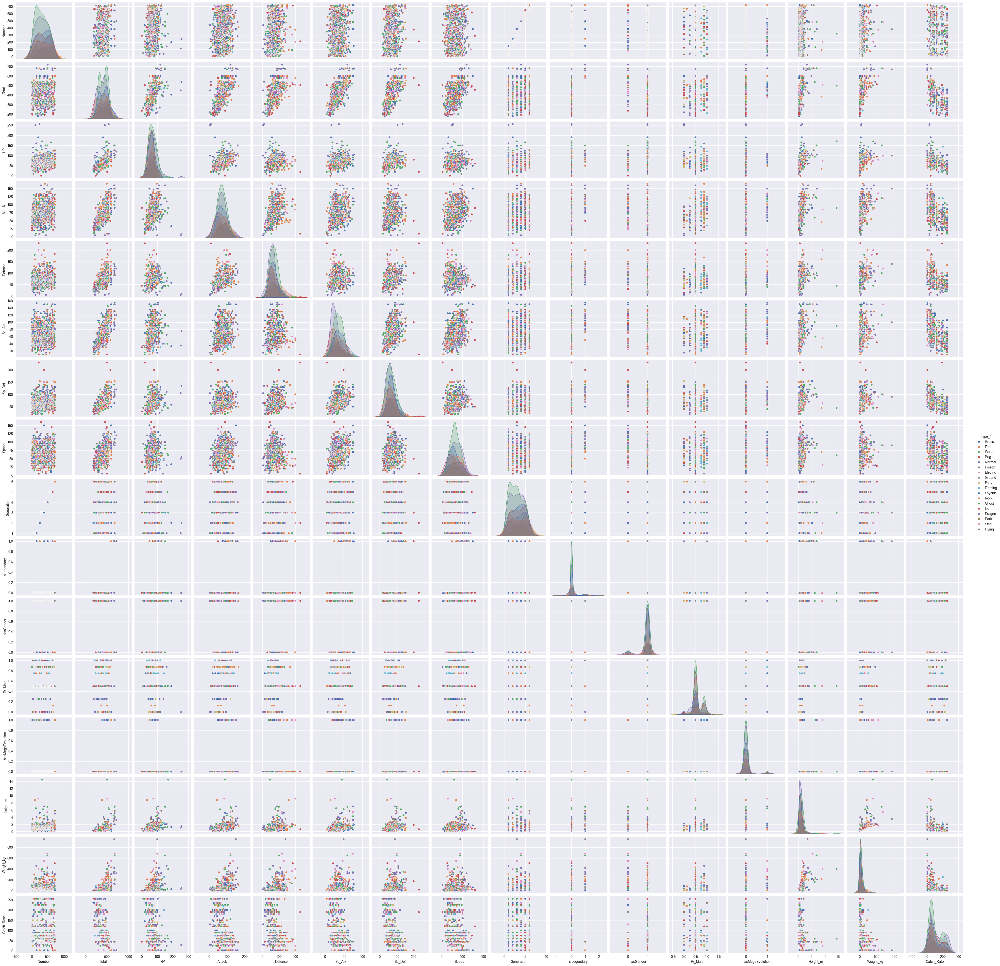

In [3]:
sns.pairplot(df, hue='Type_1', palette="deep")

<Axes: >

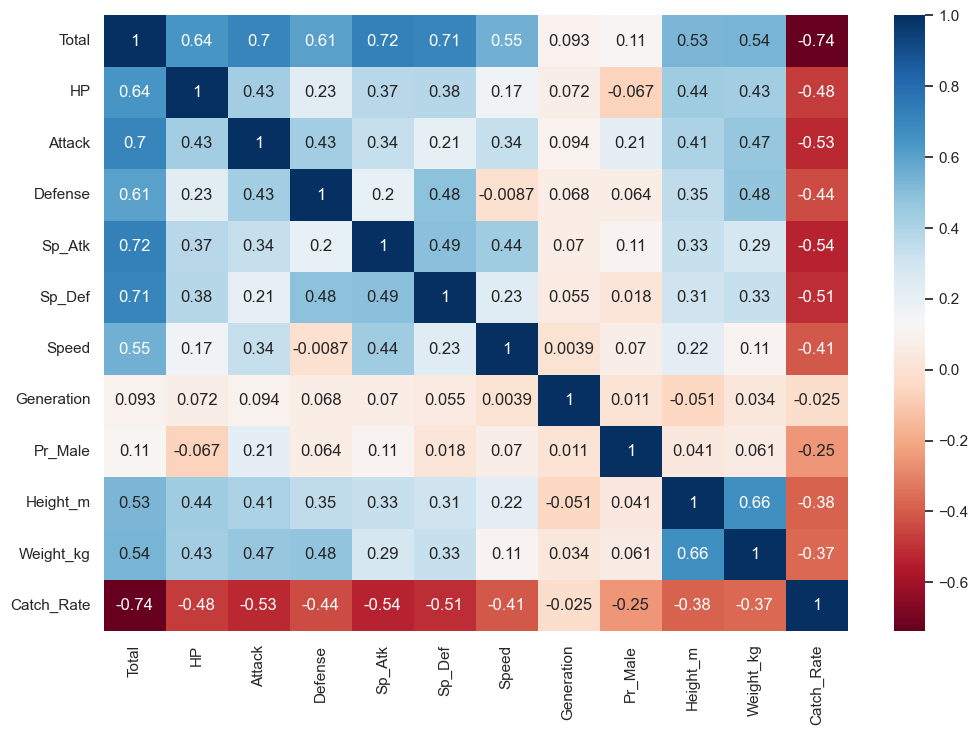

In [4]:
# gráfico de correlação baseados nos atributos físicos dos Pokémon
sns.set(rc={'figure.figsize':(12,8)})
sns.heatmap(df.iloc[:,[4,5,6,7,8,9,10,11,15,19,20,21]].corr(), annot=True, cmap='RdBu', square=True) # 

In [5]:
padronizado = StandardScaler()

entrada_padronizada = padronizado.fit_transform(df.iloc[:,[5,6,7,8,9,10]])


pca = PCA(n_components=2)
duas_dimensoes = pca.fit_transform(df.iloc[:,[5,6,7,8,9,10]])



In [6]:
tipo = df.Type_1

encoder = LabelEncoder()
tipo = encoder.fit_transform(tipo)

tipo

array([ 9,  9,  9,  6,  6,  6, 17, 17, 17,  0,  0,  0,  0,  0,  0, 12, 12,
       12, 12, 12, 12, 12, 13, 13,  3,  3, 10, 10, 13, 13, 13, 13, 13, 13,
        4,  4,  6,  6, 12, 12, 13, 13,  9,  9,  9,  0,  0,  0,  0, 10, 10,
       12, 12, 17, 17,  5,  5,  6,  6, 17, 17, 17, 14, 14, 14,  5,  5,  5,
        9,  9,  9, 17, 17, 15, 15, 15,  6,  6, 17, 17,  3,  3, 12, 12, 12,
       17, 17, 13, 13, 17, 17,  8,  8,  8, 15, 14, 14, 17, 17,  3,  3,  9,
        9, 10, 10,  5,  5, 12, 13, 13, 10, 10, 12,  9, 12, 17, 17, 17, 17,
       17, 17, 14,  0, 11,  3,  6,  0, 12, 17, 17, 17, 12, 12, 17,  3,  6,
       12, 15, 15, 15, 15, 15, 12, 11,  3,  6,  2,  2,  2, 14, 14,  9,  9,
        9,  6,  6,  6, 17, 17, 17, 12, 12, 12, 12,  0,  0,  0,  0, 13, 17,
       17,  3,  4, 12,  4,  4, 14, 14,  3,  3,  3,  9, 17, 17, 15, 17,  9,
        9,  9, 12,  9,  9,  0, 17, 17, 14,  1,  1, 17,  8, 14, 14, 12,  0,
        0, 12, 10, 16,  4,  4, 17,  0,  0,  0,  1, 12, 12,  6,  6, 11, 11,
       17, 17, 17, 11, 17

Text(0, 0.5, 'inertia')

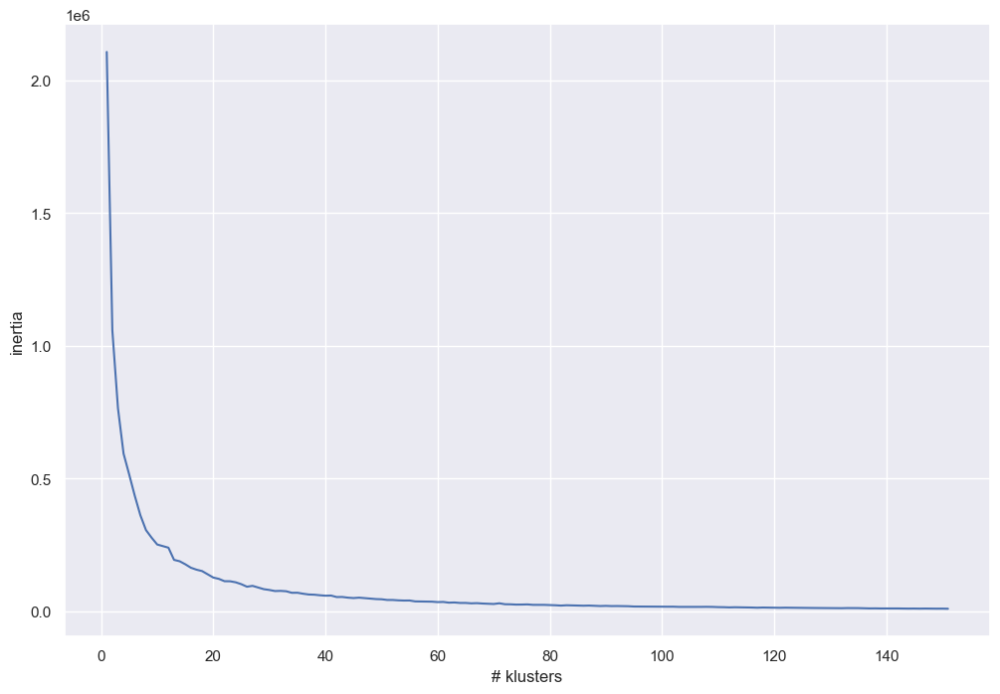

In [7]:
inertia=[]
for i in range(1,152):
    kmeans = KMeans(n_clusters=i, n_init='auto')
    kmeans.fit(duas_dimensoes)
    inertia.append(kmeans.inertia_)

plt.plot(list(range(1,152)), inertia)
plt.xlabel("# klusters")
plt.ylabel("inertia")

Text(0.5, 1.0, 'Dataset real')

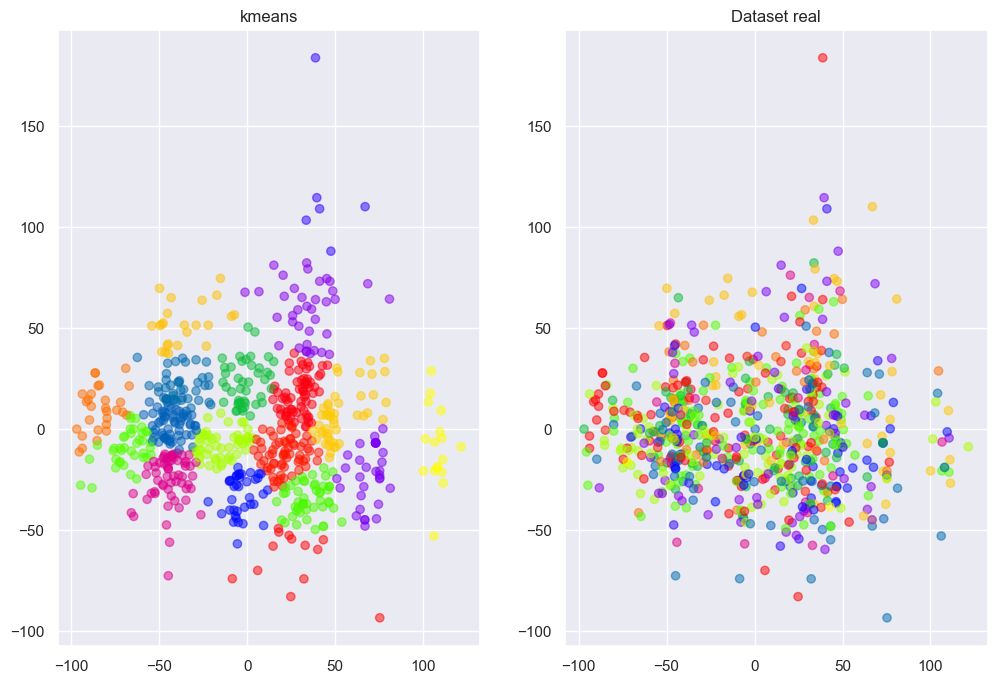

In [8]:
kmeans = KMeans(n_clusters=18, n_init='auto')
kmeans.fit(duas_dimensoes)
solucao = kmeans.predict(duas_dimensoes)

plt.subplot(1,2,1)
plt.scatter(duas_dimensoes[:,0], duas_dimensoes[:,1],
            c=solucao, alpha=0.5, cmap='prism')
plt.title("kmeans")

plt.subplot(1,2,2)
plt.scatter(duas_dimensoes[:,0], duas_dimensoes[:,1], c=tipo, alpha=0.5, cmap='prism') # arrumar para tipos
plt.title("Dataset real")

Sem PCA

In [9]:
padronizado = StandardScaler()

entrada_padronizada = padronizado.fit_transform(df.iloc[:,[5,6,7,8,9,10]])

duas_dimensoes = padronizado.fit_transform(df.iloc[:,[5,6,7,8,9,10]])

Text(0, 0.5, 'inertia')

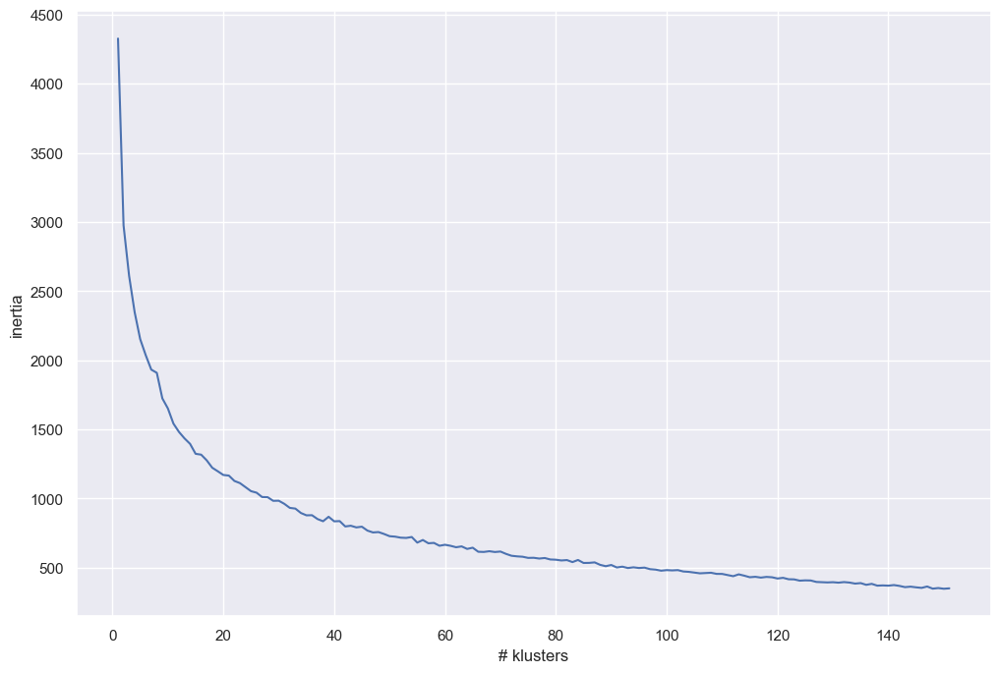

In [10]:
inertia=[]
for i in range(1,152):
    kmeans = KMeans(n_clusters=i, n_init='auto')
    kmeans.fit(duas_dimensoes)
    inertia.append(kmeans.inertia_)

plt.plot(list(range(1,152)), inertia)
plt.xlabel("# klusters")
plt.ylabel("inertia")

Text(0.5, 1.0, 'Dataset real')

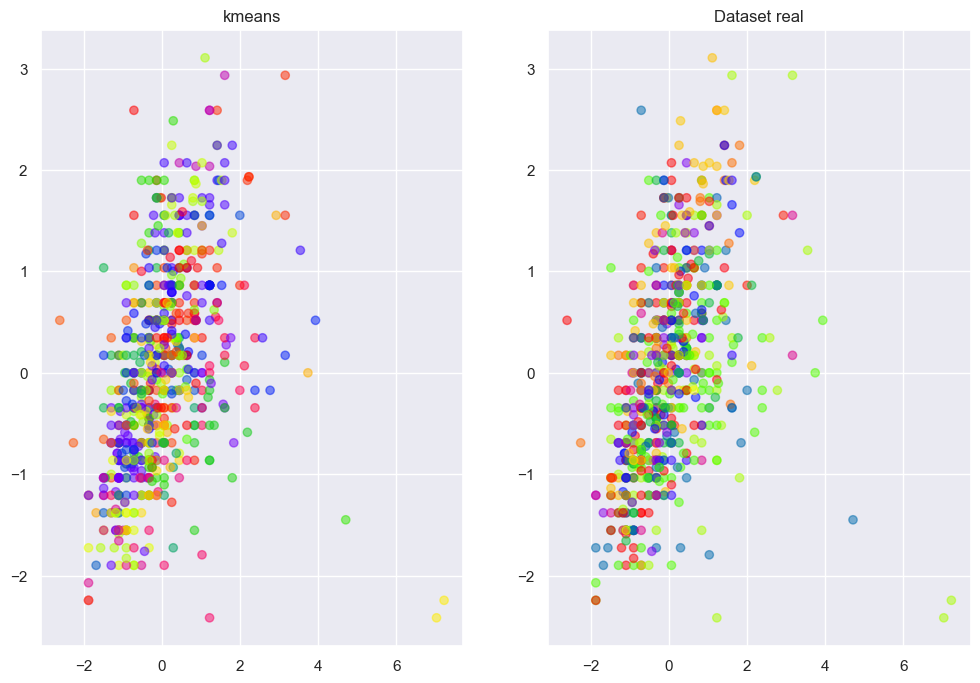

In [11]:
kmeans = KMeans(n_clusters=75, n_init='auto')
kmeans.fit(duas_dimensoes)
solucao = kmeans.predict(duas_dimensoes)

plt.subplot(1,2,1)
plt.scatter(duas_dimensoes[:,0], duas_dimensoes[:,1],
            c=solucao, alpha=0.5, cmap='prism')
plt.title("kmeans")

plt.subplot(1,2,2)
plt.scatter(duas_dimensoes[:,0], duas_dimensoes[:,1], c=tipo, alpha=0.5, cmap='prism') # arrumar para tipos
plt.title("Dataset real")

o__________________________________________________________________o

In [12]:
# pokedex = pd.read_csv('pokemon.csv')
# pokedex

,abilities,against_bug,against_dark,against_dragon,against_electric,against_fairy,against_fight,against_fire,against_flying,against_ghost,...,percentage_male,pokedex_number,sp_attack,sp_defense,speed,type1,type2,weight_kg,generation,is_legendary
0,"['Overgrow', 'Chlorophyll']",1.00,1.0,1.0,0.5,0.5,0.5,2.0,2.0,1.0,...,88.1,1,65,65,45,grass,poison,6.9,1,0
1,"['Overgrow', 'Chlorophyll']",1.00,1.0,1.0,0.5,0.5,0.5,2.0,2.0,1.0,...,88.1,2,80,80,60,grass,poison,13.0,1,0
2,"['Overgrow', 'Chlorophyll']",1.00,1.0,1.0,0.5,0.5,0.5,2.0,2.0,1.0,...,88.1,3,122,120,80,grass,poison,100.0,1,0
3,"['Blaze', 'Solar Power']",0.50,1.0,1.0,1.0,0.5,1.0,0.5,1.0,1.0,...,88.1,4,60,50,65,fire,NaN,8.5,1,0
4,"['Blaze', 'Solar Power']",0.50,1.0,1.0,1.0,0.5,1.0,0.5,1.0,1.0,...,88.1,5,80,65,80,fire,NaN,19.0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
796,['Beast Boost'],0.25,1.0,0.5,2.0,0.5,1.0,2.0,0.5,1.0,...,NaN,797,107,101,61,steel,flying,999.9,7,1
797,['Beast Boost'],1.00,1.0,0.5,0.5,0.5,2.0,4.0,1.0,1.0,...,NaN,798,59,31,109,grass,steel,0.1,7,1
798,['Beast Boost'],2.00,0.5,2.0,0.5,4.0,2.0,0.5,1.0,0.5,...,NaN,799,97,53,43,dark,dragon,888.0,7,1
799,['Prism Armor'],2.00,2.0,1.0,1.0,1.0,0.5,1.0,1.0,2.0,...,NaN,800,127,89,79,psychic,NaN,230.0,7,1


In [13]:
# sns.pairplot(pokedex, hue='type1', palette="deep")

In [36]:
# stats = list(zip(pokedex.against_bug, pokedex.against_dark, pokedex.against_dragon, pokedex.against_electric, pokedex.against_fairy, 
#                  pokedex.against_fight, pokedex.against_fire, pokedex.against_flying, pokedex.against_ghost, pokedex.against_grass, 
#                  pokedex.against_ground, pokedex.against_ice, pokedex.against_normal, pokedex.against_poison, pokedex.against_psychic, 
#                  pokedex.against_rock, pokedex.against_steel, pokedex.against_water))
# 
# status = [list(item) for item in stats]

In [37]:
# tipo = pokedex.type1
# 
# encoder = LabelEncoder()
# tipo = encoder.fit_transform(tipo)
# 
# tipo

array([ 9,  9,  9,  6,  6,  6, 17, 17, 17,  0,  0,  0,  0,  0,  0, 12, 12,
       12, 12, 12, 12, 12, 13, 13,  3,  3, 10, 10, 13, 13, 13, 13, 13, 13,
        4,  4,  6,  6, 12, 12, 13, 13,  9,  9,  9,  0,  0,  0,  0, 10, 10,
       12, 12, 17, 17,  5,  5,  6,  6, 17, 17, 17, 14, 14, 14,  5,  5,  5,
        9,  9,  9, 17, 17, 15, 15, 15,  6,  6, 17, 17,  3,  3, 12, 12, 12,
       17, 17, 13, 13, 17, 17,  8,  8,  8, 15, 14, 14, 17, 17,  3,  3,  9,
        9, 10, 10,  5,  5, 12, 13, 13, 10, 10, 12,  9, 12, 17, 17, 17, 17,
       17, 17, 14,  0, 11,  3,  6,  0, 12, 17, 17, 17, 12, 12, 17,  3,  6,
       12, 15, 15, 15, 15, 15, 12, 11,  3,  6,  2,  2,  2, 14, 14,  9,  9,
        9,  6,  6,  6, 17, 17, 17, 12, 12, 12, 12,  0,  0,  0,  0, 13, 17,
       17,  3,  4, 12,  4,  4, 14, 14,  3,  3,  3,  9, 17, 17, 15, 17,  9,
        9,  9, 12,  9,  9,  0, 17, 17, 14,  1,  1, 17,  8, 14, 14, 12,  0,
        0, 12, 10, 16,  4,  4, 17,  0,  0,  0,  1, 12, 12,  6,  6, 11, 11,
       17, 17, 17, 11, 17

In [38]:
# padronizado = StandardScaler()
# 
# entrada_padronizada = padronizado.fit_transform(status)
# 
# 
# pca = PCA(n_components=2)
# duas_dimensoes = pca.fit_transform(status)

C:\Users\quiri\OneDrive\Área de Trabalho\Trabalhos\8° semestre\IA e aprendizado de maquina\IA_ML\.venv\Lib\site-packages\sklearn\base.py:1473: ConvergenceWarning: Number of distinct clusters (135) found smaller than n_clusters (136). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)
C:\Users\quiri\OneDrive\Área de Trabalho\Trabalhos\8° semestre\IA e aprendizado de maquina\IA_ML\.venv\Lib\site-packages\sklearn\base.py:1473: ConvergenceWarning: Number of distinct clusters (135) found smaller than n_clusters (137). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)
C:\Users\quiri\OneDrive\Área de Trabalho\Trabalhos\8° semestre\IA e aprendizado de maquina\IA_ML\.venv\Lib\site-packages\sklearn\base.py:1473: ConvergenceWarning: Number of distinct clusters (135) found smaller than n_clusters (138). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)
C:\Users\quiri\OneDrive\Área de Traba

Text(0, 0.5, 'inertia')

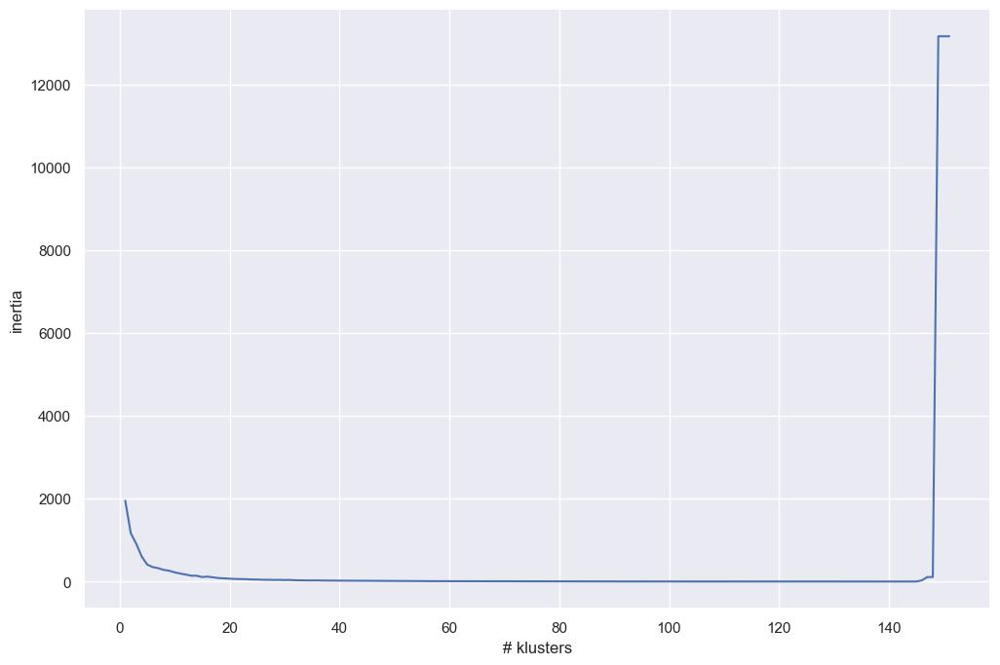

In [39]:
# inertia=[]
# for i in range(1,152):
#     kmeans = KMeans(n_clusters=i, n_init='auto')
#     kmeans.fit(duas_dimensoes)
#     inertia.append(kmeans.inertia_)
# 
# plt.plot(list(range(1,152)), inertia)
# plt.xlabel("# klusters")
# plt.ylabel("inertia")

Text(0.5, 1.0, 'Dataset real')

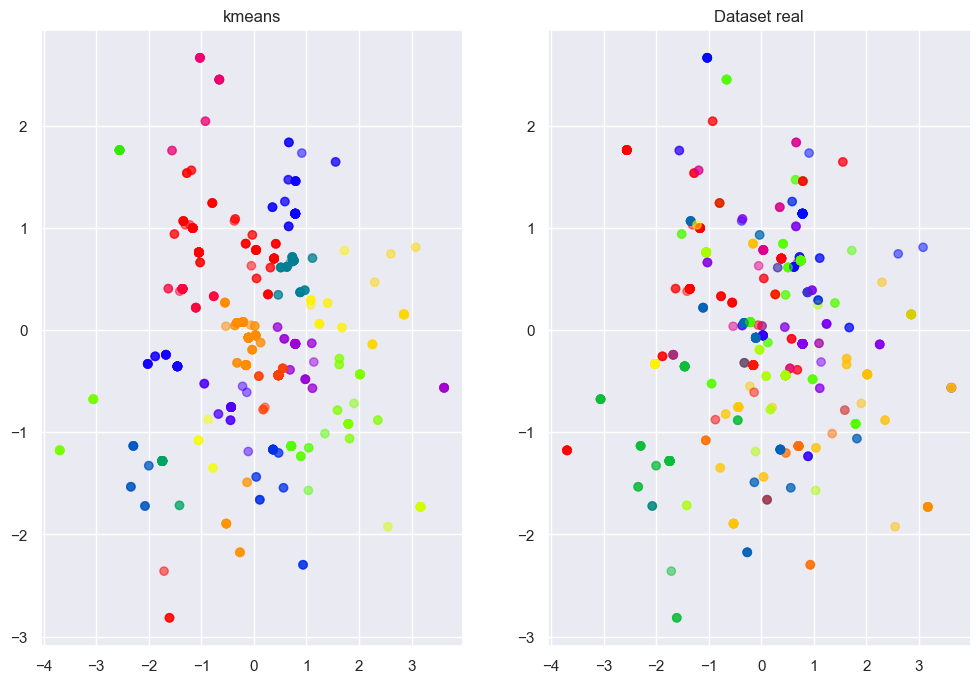

In [22]:
# kmeans = KMeans(n_clusters=25, n_init='auto')
# kmeans.fit(duas_dimensoes)
# solucao = kmeans.predict(duas_dimensoes)
# 
# plt.subplot(1,2,1)
# plt.scatter(duas_dimensoes[:,0], duas_dimensoes[:,1],
#             c=solucao, alpha=0.5, cmap='prism')
# plt.title("kmeans")
# 
# plt.subplot(1,2,2)
# plt.scatter(duas_dimensoes[:,0], duas_dimensoes[:,1], c=tipo, alpha=0.5, cmap='prism') # arrumar para tipos
# plt.title("Dataset real")